Install required packages

In [1]:
! pip install numpy


[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
! pip install pandas



[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
! pip install networkx


[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [4]:
! pip install matplotlib


[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [5]:
! pip install matplotlib-inline


[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [6]:
! pip install community


[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [7]:
! pip install python-louvain


[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [8]:
! pip install scipy


[notice] A new release of pip available: 22.3 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [9]:
import pandas as pd

Just need only 2 columns: "Genre" and "Publisher"

In [10]:
df = pd.read_csv('vgsales.csv', usecols = ['Genre', 'Publisher'])
df_new = df.dropna().drop_duplicates()
df_new

,Genre,Publisher
0,Sports,Nintendo
1,Platform,Nintendo
2,Racing,Nintendo
4,Role-Playing,Nintendo
5,Puzzle,Nintendo
...,...,...
16565,Platform,Rain Games
16566,Strategy,Trion Worlds
16570,Simulation,UIG Entertainment
16589,Action,dramatic create


Get graph's info

In [11]:
import networkx as nx
from networkx.algorithms import bipartite
g_1 = nx.Graph()
publishers = df_new['Publisher']
genres = df_new['Genre']
print("Number of publishers: ", publishers.nunique())
print("Number of genres: ", genres.nunique())
print("Number of edges: ", len(df_new))

Number of publishers:  578
Number of genres:  12
Number of edges:  1825


Draw the bipartite graph and the non bipartite graph

In [12]:
for index, row in df_new.iterrows():
    g_1.add_edge(row['Genre'], row['Publisher'], weight = 1)
    g_1.add_nodes_from(genres, bipartite = 0)
    g_1.add_nodes_from(publishers, bipartite = 1)

<Figure size 1500x1500 with 0 Axes>

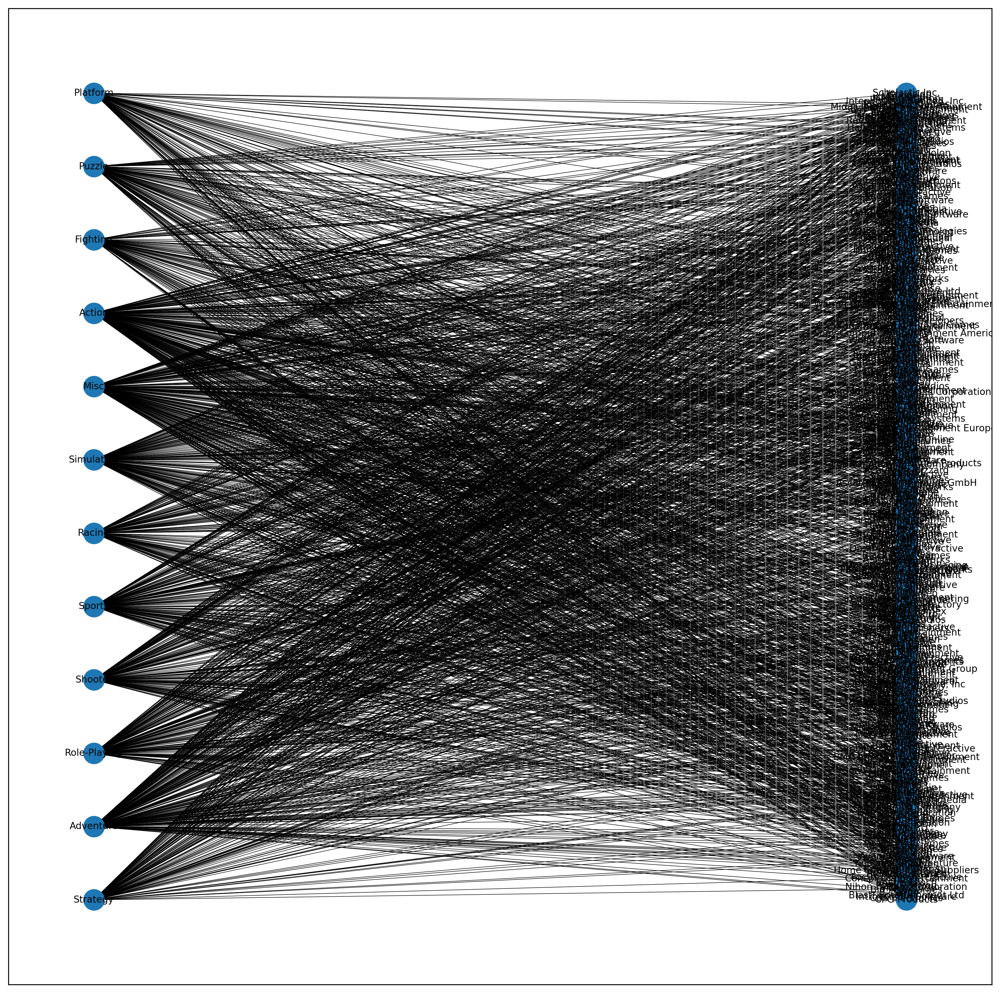

In [13]:
import matplotlib.pyplot as plt
plt.figure(figsize = (15, 15))
pos = nx.spring_layout(g_1)
fig, ax = plt.subplots(1, 1, figsize = (15, 15), dpi = 300)
nx.draw_networkx(g_1, pos = nx.drawing.layout.bipartite_layout(g_1, genres), font_size = 8, width = 0.4)

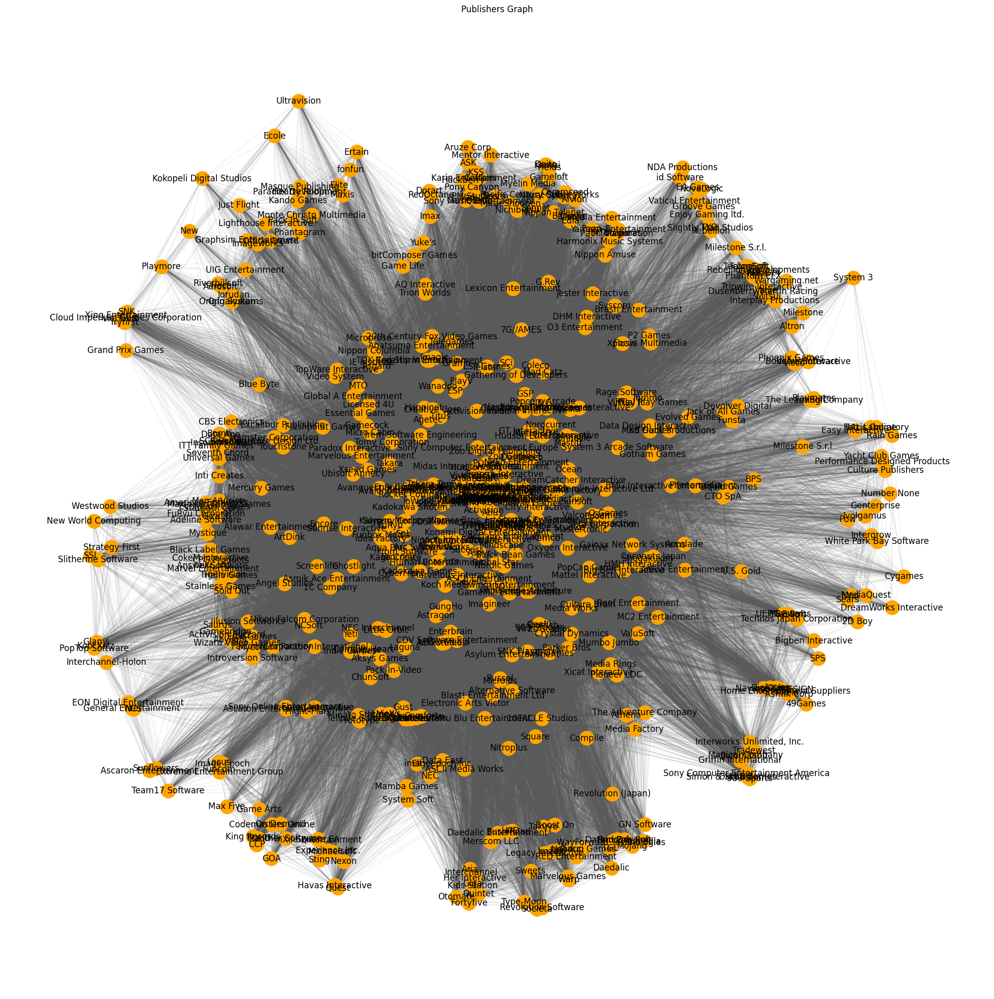

In [14]:
# Remove duplicated publishers from rows of the publishers dataframe 
# (because we need unique publishers to put into the graph):
final_publishers = publishers.drop_duplicates()
g_2 = bipartite.weighted_projected_graph(g_1, final_publishers)
plt.figure(figsize = (25, 25))

layout = nx.spring_layout(g_2)

nx.draw_networkx_nodes(
    g_2,
    layout,
    nodelist = final_publishers,
    node_size = 400,
    node_color = 'orange'
)
nx.draw_networkx_edges(g_2, layout, edge_color = '#5A5A5A', alpha = 0.1)
node_labels = dict(zip(final_publishers, final_publishers))
nx.draw_networkx_labels(g_2, layout, labels = node_labels)
plt.axis('off')
plt.title('Publishers Graph')

plt.show()


Export the non bipartite graph data to a .csv file (to use in Gephi)

In [15]:
labels = nx.get_edge_attributes(g_2, 'weight')
df2 = pd.DataFrame(columns = ['source', 'target', 'weight'])
for key, value in labels.items():
    df2 = df2.append({'source': key[0], 'target': key[1], 'weight': value}, ignore_index = True)
# Export to .csv file to be used in Gephi
df2.to_csv('for_gephi.csv', index = False, header = True)
# If this file is compiled with Google Colab please add '/' before the file name to get the 
# exported csv in the root directory as below:
# df2.to_csv('/for_gephi.csv', index = False, header = True)

Communities detection with Louvain algorithm

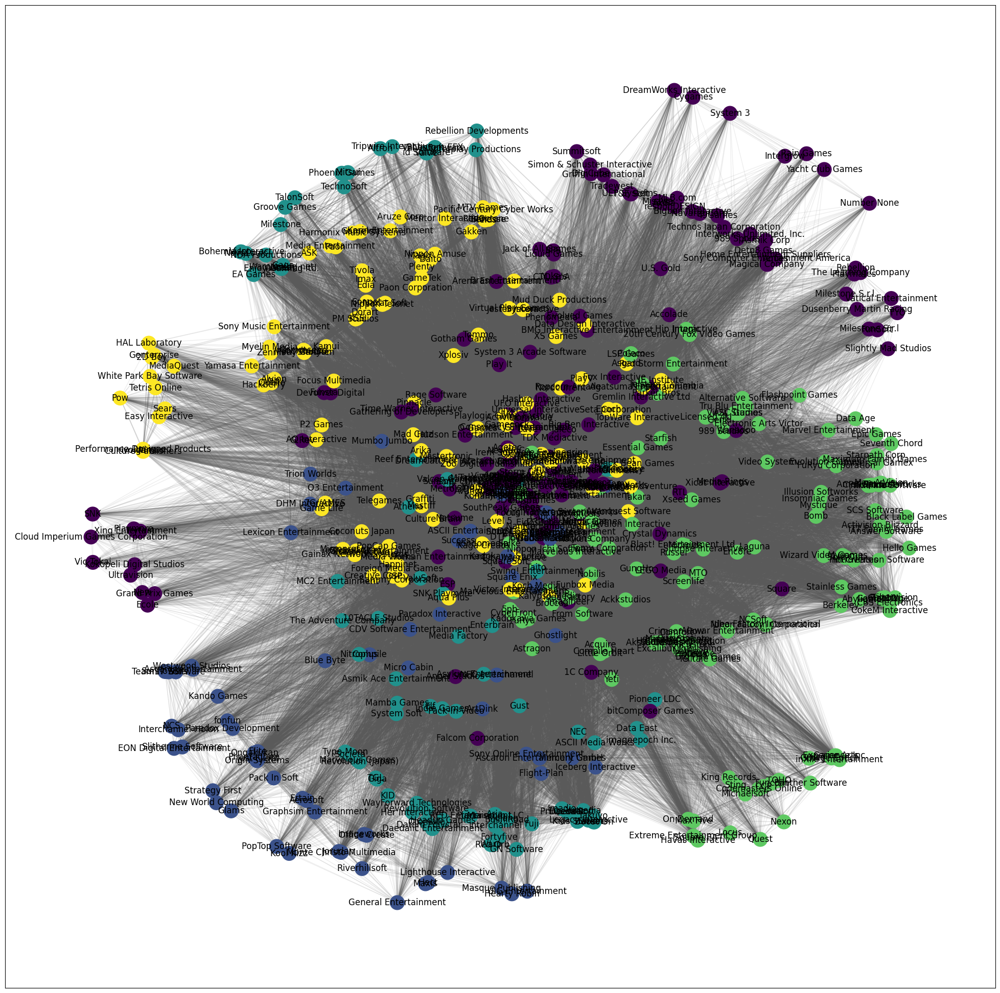

In [73]:
import matplotlib.cm as cm
import matplotlib
from community import community_louvain

plt.figure(figsize = (25, 25))

# Compute the best partition
partition = community_louvain.best_partition(g_2)

# Draw the graph
pos = nx.spring_layout(g_2)
# Color the nodes according to their partitions
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx_nodes(g_2, pos, partition.keys(), node_size = 400, cmap = cmap, 
node_color=list(partition.values()))
nx.draw_networkx_edges(g_2, pos, alpha = 0.1, edge_color = '#5A5A5A')
nx.draw_networkx_labels(g_2, pos)

plt.show()

Calculate number of communities and show the members of each community

In [74]:
import numpy as np
values = list(partition.values())

# Print number of communities
print('Number of communities: ', len(np.unique(values)))

Number of communities:  5


In [75]:
for i in range(len(np.unique(values))):
    print("---------", "Community ", i + 1, "---------")
    print("")
    for name, k in partition.items():
        if k == i:
            print(name)
    print("")

--------- Community  1 ---------

Nintendo
Microsoft Game Studios
Take-Two Interactive
Sony Computer Entertainment
Activision
Ubisoft
Electronic Arts
Sega
SquareSoft
Atari
505 Games
Capcom
GT Interactive
Konami Digital Entertainment
Virgin Interactive
Warner Bros. Interactive Entertainment
Universal Interactive
Eidos Interactive
Vivendi Games
Namco Bandai Games
Hasbro Interactive
THQ
Fox Interactive
Acclaim Entertainment
Disney Interactive Studios
Majesco Entertainment
Arena Entertainment
Midway Games
JVC
Deep Silver
UEP Systems
Tecmo Koei
Infogrames
Unknown
Square
Banpresto
D3Publisher
Global Star
Gotham Games
Crave Entertainment
Hudson Soft
Rising Star Games
Atlus
TDK Mediactive
Accolade
3DO
RTL
Natsume
SouthPeak Games
Ocean
Zoo Digital Publishing
Psygnosis
Empire Interactive
Agetec
Play It
Slightly Mad Studios
Game Factory
Titus
CTO SpA
Crystal Dynamics
SCi
Rage Software
Interplay
Hudson Entertainment
Big Ben Interactive
LEGO Media
Metro 3D
Sony Computer Entertainment America
BMG In

Analyse genres of each community to get to know its meaning

Analyse genres of each community

--------- Community  1 ---------

Sports: 97
Platform: 79
Racing: 91
Role-Playing: 56
Puzzle: 55
Misc: 61
Shooter: 76
Simulation: 52
Action: 63
Fighting: 76
Adventure: 53
Strategy: 48



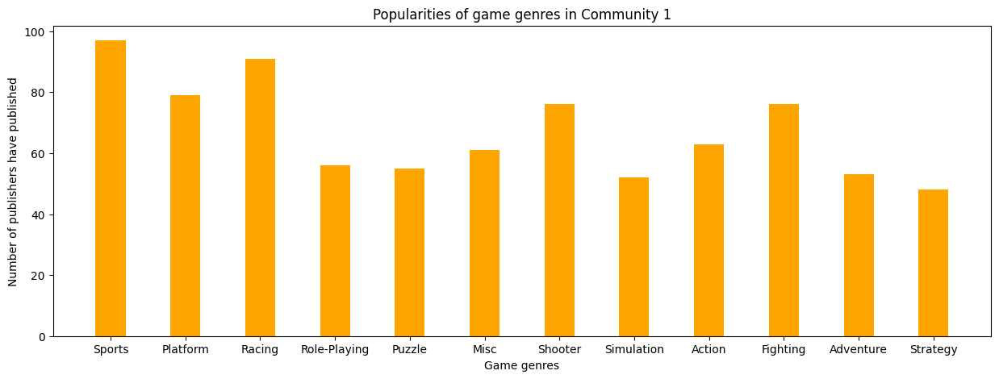


--------- Community  2 ---------

Sports: 11
Platform: 2
Racing: 5
Role-Playing: 22
Puzzle: 14
Misc: 10
Shooter: 10
Simulation: 45
Action: 10
Fighting: 1
Adventure: 12
Strategy: 38



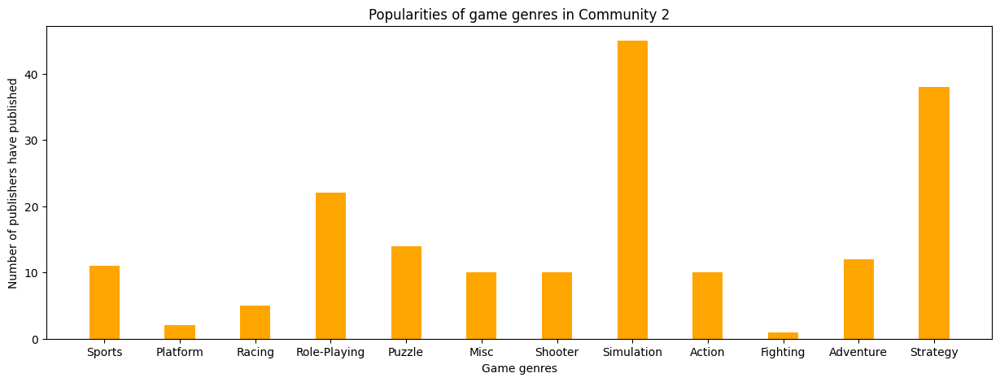


--------- Community  3 ---------

Sports: 6
Platform: 3
Racing: 4
Role-Playing: 7
Puzzle: 4
Misc: 1
Shooter: 31
Simulation: 8
Action: 3
Fighting: 4
Adventure: 63
Strategy: 5



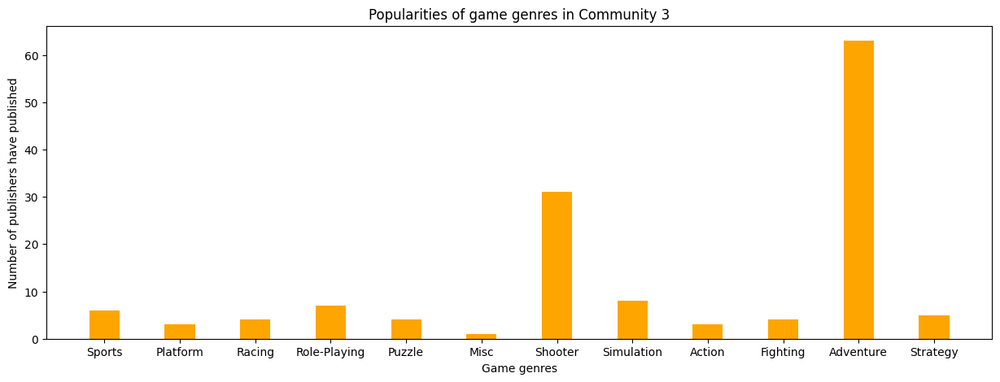


--------- Community  4 ---------

Sports: 18
Platform: 6
Racing: 15
Role-Playing: 60
Puzzle: 3
Misc: 21
Shooter: 19
Simulation: 22
Action: 120
Fighting: 15
Adventure: 40
Strategy: 12



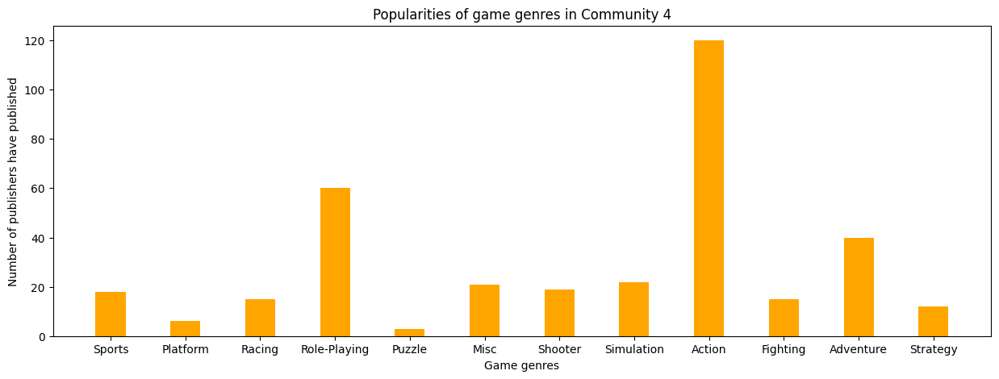


--------- Community  5 ---------

Sports: 31
Platform: 7
Racing: 13
Role-Playing: 13
Puzzle: 40
Misc: 117
Shooter: 14
Simulation: 23
Action: 32
Fighting: 4
Adventure: 38
Strategy: 16



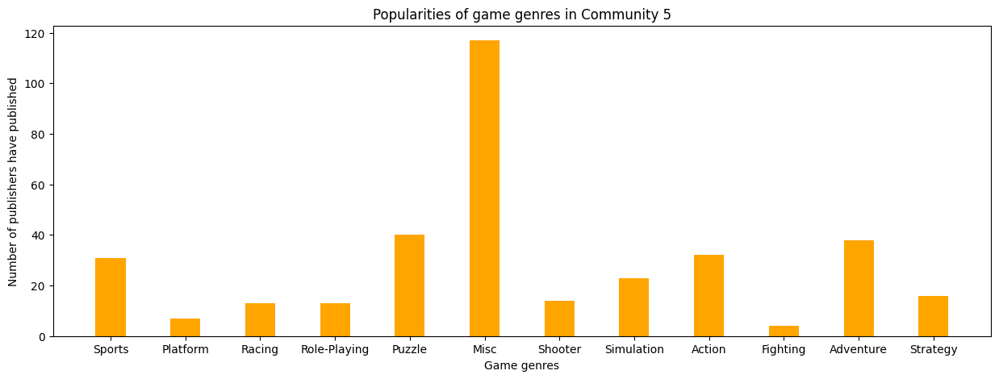

In [76]:
# Remove duplicated genres from rows of the genres dataframe 
# (because we need unique genres):
final_genres = genres.drop_duplicates()
comNodes = []
print("Analyse genres of each community")
print("")

for c in range(len(np.unique(values))):
    comNodes.clear()
    genresValues = []
    print("---------", "Community ", c + 1, "---------")
    print("")
    for name, k in partition.items():
        if k == c:
            comNodes.append(name)
    for genre in final_genres:
        hasGenreCount = 0
        for i in comNodes:
            # Search in the dataframe if this publisher in this community
            # has a connection to this genre or not
            if ((df_new['Genre'] == genre) & (df_new['Publisher'] == i)).any():
                hasGenreCount = hasGenreCount + 1
        genresValues.append(hasGenreCount)
        print(genre + ": " + str(hasGenreCount))

    # Draw bar chart    
    print("")
    fig = plt.figure(figsize = (15, 5))
    # Creating the bar plot
    plt.bar(final_genres, genresValues, color ='orange', width = 0.4)
    plt.xlabel("Game genres")
    plt.ylabel("Number of publishers have published")
    plt.title("Popularities of game genres in Community " + str(c + 1))
    plt.show()
    print("")

Node ranking algorithms

1. PageRank

In [97]:
pr = nx.pagerank(g_2)
for k, v in sorted(pr.items(), key=lambda item: item[1], reverse=True):
    print(k, ": ", v)

Nintendo :  0.005465027145877209
Microsoft Game Studios :  0.005465027145877209
Take-Two Interactive :  0.005465027145877209
Sony Computer Entertainment :  0.005465027145877209
Activision :  0.005465027145877209
Ubisoft :  0.005465027145877209
Electronic Arts :  0.005465027145877209
Sega :  0.005465027145877209
Atari :  0.005465027145877209
505 Games :  0.005465027145877209
Capcom :  0.005465027145877209
Konami Digital Entertainment :  0.005465027145877209
Virgin Interactive :  0.005465027145877209
Eidos Interactive :  0.005465027145877209
Vivendi Games :  0.005465027145877209
Namco Bandai Games :  0.005465027145877209
THQ :  0.005465027145877209
Majesco Entertainment :  0.005465027145877209
Deep Silver :  0.005465027145877209
Unknown :  0.005465027145877209
Banpresto :  0.005465027145877209
D3Publisher :  0.005465027145877209
Crave Entertainment :  0.005465027145877209
SouthPeak Games :  0.005193271449076433
Tecmo Koei :  0.005131309986833589
Infogrames :  0.005131309986833589
Atlus :

2. Eigenvector Centrality

In [98]:
eigen_centrality = nx.eigenvector_centrality(g_2)
for k, v in sorted(eigen_centrality.items(), key=lambda item: item[1], reverse=True):
    print(k, ": ", v)

Nintendo :  0.06657201149659496
Microsoft Game Studios :  0.06657201149659496
Take-Two Interactive :  0.06657201149659496
Sony Computer Entertainment :  0.06657201149659496
Activision :  0.06657201149659496
Ubisoft :  0.06657201149659496
Electronic Arts :  0.06657201149659496
Sega :  0.06657201149659496
Atari :  0.06657201149659496
505 Games :  0.06657201149659496
Capcom :  0.06657201149659496
Konami Digital Entertainment :  0.06657201149659496
Virgin Interactive :  0.06657201149659496
Eidos Interactive :  0.06657201149659496
Vivendi Games :  0.06657201149659496
Namco Bandai Games :  0.06657201149659496
THQ :  0.06657201149659496
Majesco Entertainment :  0.06657201149659496
Deep Silver :  0.06657201149659496
Unknown :  0.06657201149659496
Banpresto :  0.06657201149659496
D3Publisher :  0.06657201149659496
Crave Entertainment :  0.06657201149659496
SouthPeak Games :  0.06625278258410582
Hudson Soft :  0.06598880990927157
Rising Star Games :  0.06598880990927157
Tecmo Koei :  0.065889207

Betweeness and closeness centrality (descending order)

1. Betweeness centrality

a. For nodes

In [99]:
bet_centrality_nodes = nx.betweenness_centrality(g_2)
for k, v in sorted(bet_centrality_nodes.items(), key=lambda item: item[1], reverse=True):
    print(k, ": ", v)

Nintendo :  0.005267974053741265
Microsoft Game Studios :  0.005267974053741265
Take-Two Interactive :  0.005267974053741265
Sony Computer Entertainment :  0.005267974053741265
Activision :  0.005267974053741265
Ubisoft :  0.005267974053741265
Electronic Arts :  0.005267974053741265
Sega :  0.005267974053741265
Atari :  0.005267974053741265
505 Games :  0.005267974053741265
Capcom :  0.005267974053741265
Konami Digital Entertainment :  0.005267974053741265
Virgin Interactive :  0.005267974053741265
Eidos Interactive :  0.005267974053741265
Vivendi Games :  0.005267974053741265
Namco Bandai Games :  0.005267974053741265
THQ :  0.005267974053741265
Majesco Entertainment :  0.005267974053741265
Deep Silver :  0.005267974053741265
Unknown :  0.005267974053741265
Banpresto :  0.005267974053741265
D3Publisher :  0.005267974053741265
Crave Entertainment :  0.005267974053741265
SouthPeak Games :  0.004960055897086254
Hudson Soft :  0.00492259773659793
Rising Star Games :  0.00492259773659793
T

b. For edges

In [100]:
bet_centrality_edges = nx.edge_betweenness_centrality(g_2)
for k, v in sorted(bet_centrality_edges.items(), key=lambda item: item[1], reverse=True):
    print(k, ": ", v)

('Nintendo', 'Cygames') :  4.983299302415959e-05
('Nintendo', 'Yacht Club Games') :  4.983299302415959e-05
('Nintendo', 'DreamWorks Interactive') :  4.983299302415959e-05
('Microsoft Game Studios', 'Cygames') :  4.983299302415959e-05
('Microsoft Game Studios', 'Yacht Club Games') :  4.983299302415959e-05
('Microsoft Game Studios', 'DreamWorks Interactive') :  4.983299302415959e-05
('Take-Two Interactive', 'Cygames') :  4.983299302415959e-05
('Take-Two Interactive', 'Yacht Club Games') :  4.983299302415959e-05
('Take-Two Interactive', 'DreamWorks Interactive') :  4.983299302415959e-05
('Sony Computer Entertainment', 'Cygames') :  4.983299302415959e-05
('Sony Computer Entertainment', 'Yacht Club Games') :  4.983299302415959e-05
('Sony Computer Entertainment', 'DreamWorks Interactive') :  4.983299302415959e-05
('Activision', 'Cygames') :  4.983299302415959e-05
('Activision', 'Yacht Club Games') :  4.983299302415959e-05
('Activision', 'DreamWorks Interactive') :  4.983299302415959e-05
('Ub

2. Closeness centrality

In [101]:
clo_centrality = nx.closeness_centrality(g_2)
for k, v in sorted(clo_centrality.items(), key=lambda item: item[1], reverse=True):
    print(k, ": ", v)

Nintendo :  1.0
Microsoft Game Studios :  1.0
Take-Two Interactive :  1.0
Sony Computer Entertainment :  1.0
Activision :  1.0
Ubisoft :  1.0
Electronic Arts :  1.0
Sega :  1.0
Atari :  1.0
505 Games :  1.0
Capcom :  1.0
Konami Digital Entertainment :  1.0
Virgin Interactive :  1.0
Eidos Interactive :  1.0
Vivendi Games :  1.0
Namco Bandai Games :  1.0
THQ :  1.0
Majesco Entertainment :  1.0
Deep Silver :  1.0
Unknown :  1.0
Banpresto :  1.0
D3Publisher :  1.0
Crave Entertainment :  1.0
SouthPeak Games :  0.988013698630137
Hudson Soft :  0.9829642248722317
Rising Star Games :  0.9829642248722317
Tecmo Koei :  0.9779661016949153
Infogrames :  0.9779661016949153
Atlus :  0.9779661016949153
Codemasters :  0.9697478991596639
Zushi Games :  0.9697478991596639
Zoo Digital Publishing :  0.9648829431438127
Empire Interactive :  0.9632721202003339
Acclaim Entertainment :  0.9616666666666667
Ignition Entertainment :  0.9616666666666667
Disney Interactive Studios :  0.956882255389718
Psygnosis : 